In [25]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

In [3]:
FILE_PATH = "../local_code/raw_data/new_columns_general_and_7_diseases_202412011734.csv"

In [4]:
df = pd.read_csv(FILE_PATH)
df.head()

,observation_id,time_observed_at_date,observed_on_date,observed_on_year,observed_on_month,observed_on_week,observed_on_day,observed_on_hour,location,place_guess,...,original_height,license_code,attribution,latitude,longitude,actual_city_name,actual_admin1,actual_admin2,actual_cc,roboflow_file_name
0,177163857,2023-08-06T13:46:00+10:00,2023-08-06,2023,8,31,6,13,"-30.3512715382,153.0816898073","Coffs Harbour NSW, Australia",...,1367,cc-by-nc-sa,"(c) Nick Lambert, some rights reserved (CC BY-...",-30.351272,153.08169,Toormina,New South Wales,Coffs Harbour,AU,177163857_0_potato_blight_phytophthora_infesta...
1,177163857,2023-08-06T13:46:00+10:00,2023-08-06,2023,8,31,6,13,"-30.3512715382,153.0816898073","Coffs Harbour NSW, Australia",...,1152,cc-by-nc-sa,"(c) Nick Lambert, some rights reserved (CC BY-...",-30.351272,153.08169,Toormina,New South Wales,Coffs Harbour,AU,177163857_1_potato_blight_phytophthora_infesta...
2,177163857,2023-08-06T13:46:00+10:00,2023-08-06,2023,8,31,6,13,"-30.3512715382,153.0816898073","Coffs Harbour NSW, Australia",...,1367,cc-by-nc-sa,"(c) Nick Lambert, some rights reserved (CC BY-...",-30.351272,153.08169,Toormina,New South Wales,Coffs Harbour,AU,177163857_2_potato_blight_phytophthora_infesta...
3,177163857,2023-08-06T13:46:00+10:00,2023-08-06,2023,8,31,6,13,"-30.3512715382,153.0816898073","Coffs Harbour NSW, Australia",...,1367,cc-by-nc-sa,"(c) Nick Lambert, some rights reserved (CC BY-...",-30.351272,153.08169,Toormina,New South Wales,Coffs Harbour,AU,177163857_3_potato_blight_phytophthora_infesta...
4,177163857,2023-08-06T13:46:00+10:00,2023-08-06,2023,8,31,6,13,"-30.3512715382,153.0816898073","Coffs Harbour NSW, Australia",...,1367,cc-by-nc-sa,"(c) Nick Lambert, some rights reserved (CC BY-...",-30.351272,153.08169,Toormina,New South Wales,Coffs Harbour,AU,177163857_4_potato_blight_phytophthora_infesta...


In [5]:
df["english_common_name"].value_counts()

english_common_name
tomato                            11636
cherry tomato                       476
potato blight                       338
unidentified                         69
Tomato Leaf Mold                     67
Septoria Leaf Spot of Tomato         62
Liriomyza leaf-mining flies          61
Spider Mites                         35
garden tomato                        25
Early Blight                         23
Leaf-miner Flies                     14
Twospotted Spider Mite               11
American Serpentine Leaf Miner        3
Vegetable Leafminer                   2
Tomato yellow leaf curl virus         2
Tobacco Spider Mite                   1
Name: count, dtype: int64

In [6]:
df["preferred_common_name"].value_counts()

preferred_common_name
tomato                            11636
cherry tomato                       476
potato blight                       338
Tomato Leaf Mold                     67
Septoria Leaf Spot of Tomato         62
Liriomyza leaf-mining flies          61
Spider Mites                         35
garden tomato                        25
Early Blight                         23
Leaf-miner Flies                     14
Twospotted Spider Mite               11
American Serpentine Leaf Miner        3
Vegetable Leafminer                   2
Tomato yellow leaf curl virus         2
Tobacco Spider Mite                   1
Name: count, dtype: int64

In [8]:
sum(df["preferred_common_name"].isna())

69

In [9]:
sum(df["english_common_name"].isna())

0

In [13]:
# Check for NaN in english_common_name
english_common_nan_mask = df["english_common_name"] == 'unidentified'

# Check for None in preferred_common_name
preferred_common_none_mask = df["preferred_common_name"].isna()

# Compare the masks
are_same = (english_common_nan_mask == preferred_common_none_mask).all()

# Output the results
print(f"Are all rows where 'english_common_name' is NaN the same as 'preferred_common_name' being None? {are_same}")

# Optionally, see rows where the masks differ
differences = df[english_common_nan_mask != preferred_common_none_mask]
print("Rows where they differ:")
differences.head()

Are all rows where 'english_common_name' is NaN the same as 'preferred_common_name' being None? True
Rows where they differ:


,observation_id,time_observed_at_date,observed_on_date,observed_on_year,observed_on_month,observed_on_week,observed_on_day,observed_on_hour,location,place_guess,...,original_height,license_code,attribution,latitude,longitude,actual_city_name,actual_admin1,actual_admin2,actual_cc,roboflow_file_name


Meaning these are same records

In [18]:
set(df["english_common_name"].unique()) | set(df["english_common_name"].unique())

{'American Serpentine Leaf Miner',
 'Early Blight',
 'Leaf-miner Flies',
 'Liriomyza leaf-mining flies',
 'Septoria Leaf Spot of Tomato',
 'Spider Mites',
 'Tobacco Spider Mite',
 'Tomato Leaf Mold',
 'Tomato yellow leaf curl virus',
 'Twospotted Spider Mite',
 'Vegetable Leafminer',
 'cherry tomato',
 'garden tomato',
 'potato blight',
 'tomato',
 'unidentified'}

In [17]:
df["english_common_name"].unique()

array(['potato blight', 'unidentified', 'Early Blight',
       'Liriomyza leaf-mining flies', 'Leaf-miner Flies',
       'American Serpentine Leaf Miner', 'Vegetable Leafminer',
       'Tomato Leaf Mold', 'Septoria Leaf Spot of Tomato', 'Spider Mites',
       'Twospotted Spider Mite', 'Tobacco Spider Mite',
       'Tomato yellow leaf curl virus', 'tomato', 'cherry tomato',
       'garden tomato'], dtype=object)

In [19]:
df[english_common_nan_mask]['roboflow_file_name']

,observation_id,time_observed_at_date,observed_on_date,observed_on_year,observed_on_month,observed_on_week,observed_on_day,observed_on_hour,location,place_guess,...,original_height,license_code,attribution,latitude,longitude,actual_city_name,actual_admin1,actual_admin2,actual_cc,roboflow_file_name
338,250579171,2024-11-02T09:40:00-04:00,2024-11-02,2024,11,44,2,9,"36.8525171345,-76.162084043","Virginia Beach, VA 23462, USA",...,1365,cc-by-nc,"(c) A, some rights reserved (CC BY-NC)",36.852517,-76.162084,Chesapeake,Virginia,City of Chesapeake,US,250579171_339_unidentified_alternaria_2024_11_...
339,250579171,2024-11-02T09:40:00-04:00,2024-11-02,2024,11,44,2,9,"36.8525171345,-76.162084043","Virginia Beach, VA 23462, USA",...,1365,cc-by-nc,"(c) A, some rights reserved (CC BY-NC)",36.852517,-76.162084,Chesapeake,Virginia,City of Chesapeake,US,250579171_340_unidentified_alternaria_2024_11_...
340,250579171,2024-11-02T09:40:00-04:00,2024-11-02,2024,11,44,2,9,"36.8525171345,-76.162084043","Virginia Beach, VA 23462, USA",...,1365,cc-by-nc,"(c) A, some rights reserved (CC BY-NC)",36.852517,-76.162084,Chesapeake,Virginia,City of Chesapeake,US,250579171_341_unidentified_alternaria_2024_11_...
341,250579171,2024-11-02T09:40:00-04:00,2024-11-02,2024,11,44,2,9,"36.8525171345,-76.162084043","Virginia Beach, VA 23462, USA",...,1365,cc-by-nc,"(c) A, some rights reserved (CC BY-NC)",36.852517,-76.162084,Chesapeake,Virginia,City of Chesapeake,US,250579171_342_unidentified_alternaria_2024_11_...
342,250579171,2024-11-02T09:40:00-04:00,2024-11-02,2024,11,44,2,9,"36.8525171345,-76.162084043","Virginia Beach, VA 23462, USA",...,1365,cc-by-nc,"(c) A, some rights reserved (CC BY-NC)",36.852517,-76.162084,Chesapeake,Virginia,City of Chesapeake,US,250579171_343_unidentified_alternaria_2024_11_...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,82603263,2021-06-11T17:02:35+00:00,2021-06-11,2021,6,23,11,17,"33.629945,-86.6620866667","Big Mountain Cir, Birmingham, AL, US",...,2048,cc-by-nc,"(c) RockyRollin, some rights reserved (CC BY-NC)",33.629945,-86.662087,Center Point,Alabama,Jefferson County,US,82603263_611_unidentified_septoria_2021_6_11_1...
611,82603263,2021-06-11T17:02:35+00:00,2021-06-11,2021,6,23,11,17,"33.629945,-86.6620866667","Big Mountain Cir, Birmingham, AL, US",...,2048,cc-by-nc,"(c) RockyRollin, some rights reserved (CC BY-NC)",33.629945,-86.662087,Center Point,Alabama,Jefferson County,US,82603263_612_unidentified_septoria_2021_6_11_1...
640,207632981,2022-10-05T16:26:00+08:00,2022-10-05,2022,10,40,5,16,"36.6864392292,117.1205688197","Jinan, CN-SD, CN",...,1365,cc-by-nc,"(c) Charles, some rights reserved (CC BY-NC)",36.686439,117.120569,Jinan,Shandong Sheng,NaN,CN,207632981_641_unidentified_tetranychus_2022_10...
641,207632981,2022-10-05T16:26:00+08:00,2022-10-05,2022,10,40,5,16,"36.6864392292,117.1205688197","Jinan, CN-SD, CN",...,1365,cc-by-nc,"(c) Charles, some rights reserved (CC BY-NC)",36.686439,117.120569,Jinan,Shandong Sheng,NaN,CN,207632981_642_unidentified_tetranychus_2022_10...


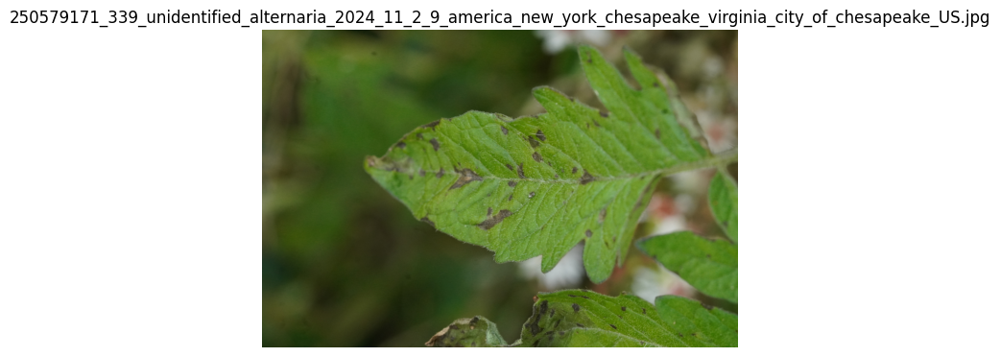

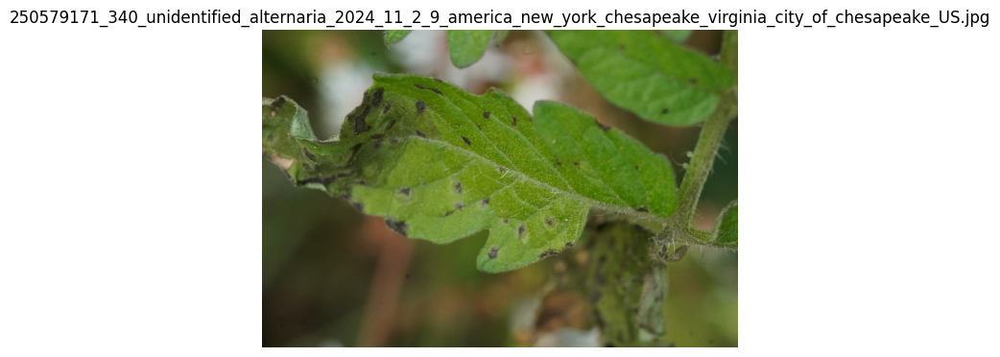

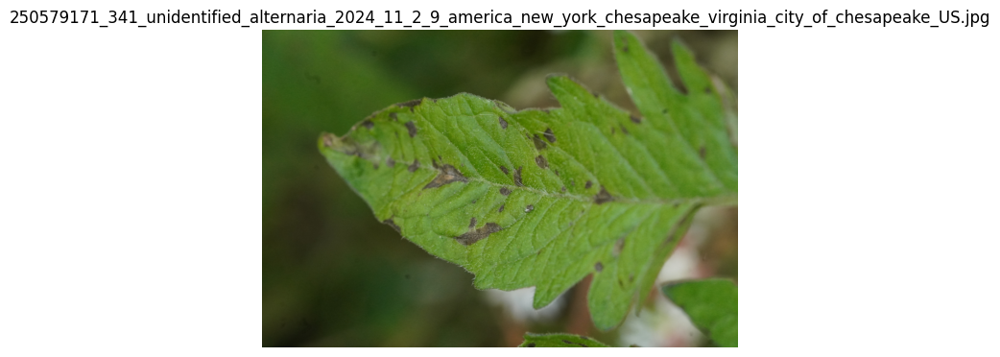

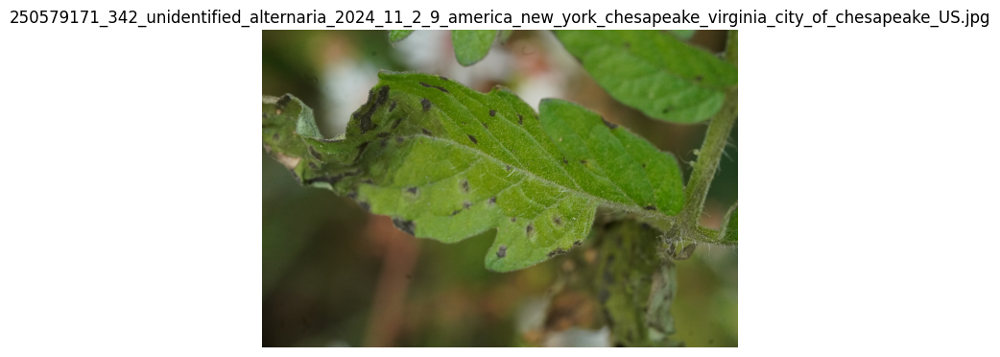

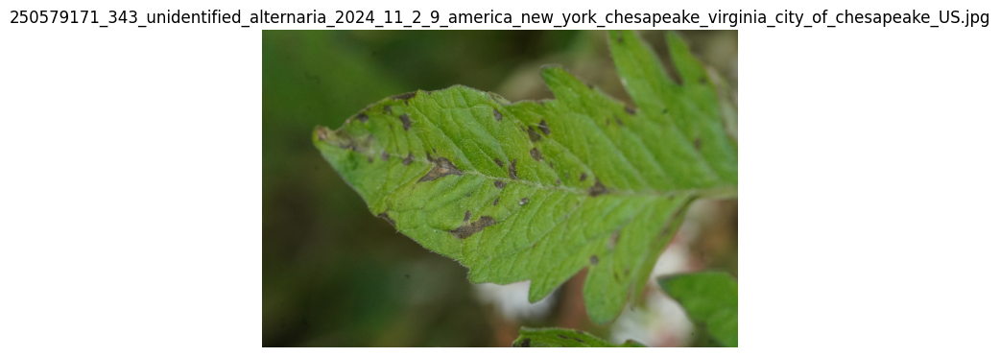

...

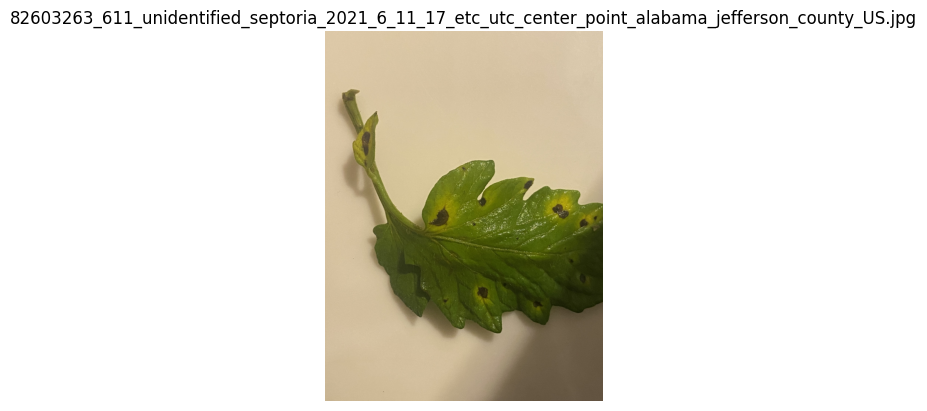

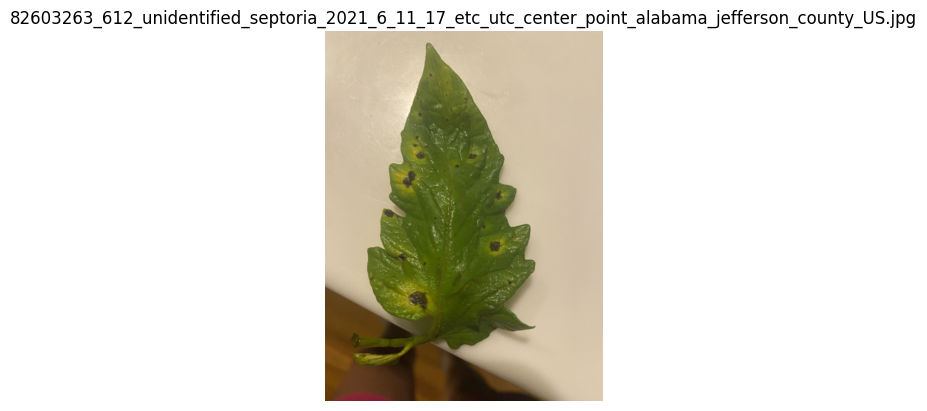

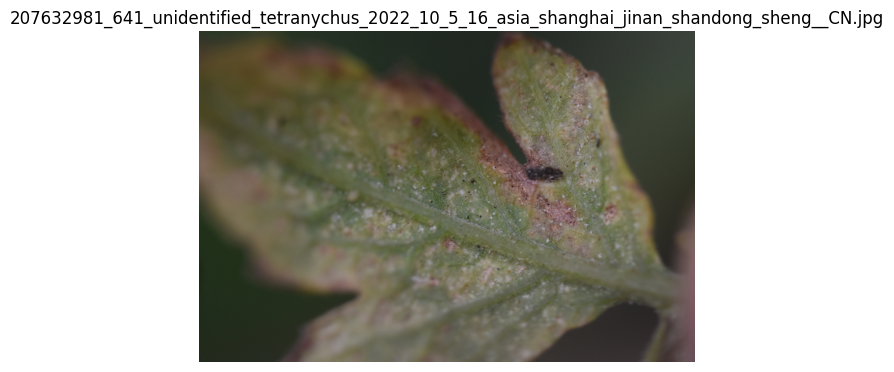

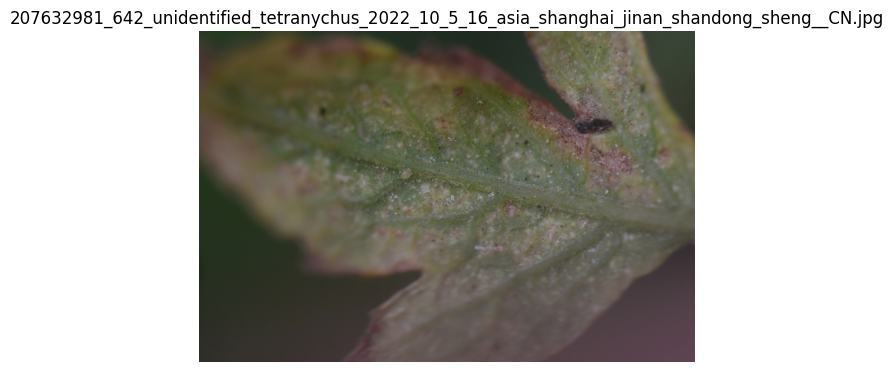

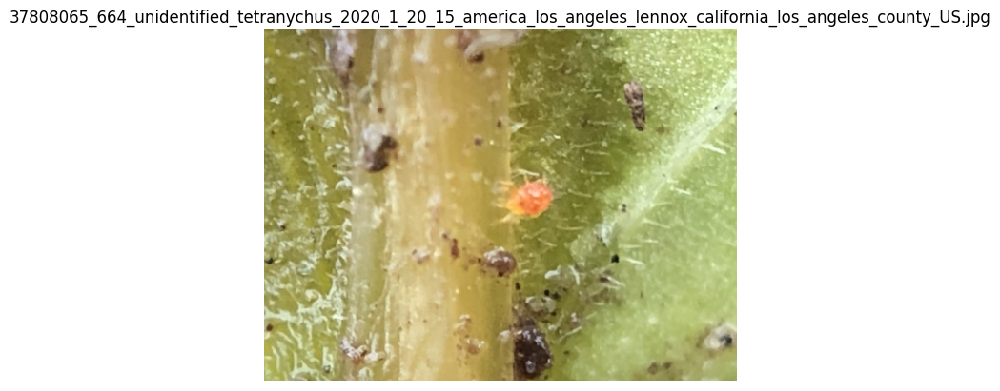

In [27]:
# Construct full paths for filtered file names
filtered_file_names = [
    f"../local_code/roboflow/downloaded_images/{file_name}.jpg"
    for file_name in df[english_common_nan_mask]['roboflow_file_name']
]

# Iterate through the file paths and visualize each image
for file_name in filtered_file_names:
    try:
        # Check if the file exists
        if not os.path.exists(file_name):
            print(f"File not found: {file_name}")
            continue

        # Load the image
        image = Image.open(file_name)

        # Display the image
        plt.figure()
        plt.imshow(image)
        plt.axis('off')  # Turn off axes for better visualization
        plt.title(os.path.basename(file_name))  # Display file name as title
        plt.show()
    except Exception as e:
        print(f"Error loading image {file_name}: {e}")